In [1]:
import pandas as pd
import numpy as np

import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer

from sklearn.preprocessing import OneHotEncoder
from category_encoders import TargetEncoder 
from sklearn.preprocessing import MinMaxScaler

from scipy.stats import uniform,stats,chi2_contingency
import joblib 

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import KFold,RandomizedSearchCV,GridSearchCV,cross_val_score
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

In [2]:
data=pd.read_csv(r"C:\Users\Tippu\Downloads\adult_census\adult.csv")
data.sample(10)
data.info()
data2=data.copy()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       32561 non-null  object
 2   fnlwgt          32561 non-null  int64 
 3   education       32561 non-null  object
 4   education-num   32561 non-null  int64 
 5   marital-status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital-gain    32561 non-null  int64 
 11  capital-loss    32561 non-null  int64 
 12  hours-per-week  32561 non-null  int64 
 13  country         32561 non-null  object
 14  salary          32561 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [3]:
data.drop(['education'],axis=1,inplace=True)
data.describe()

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week
count,32561.000000,3.256100e+04,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,1.897784e+05,10.080679,1077.648844,87.303830,40.437456
std,13.640433,1.055500e+05,2.572720,7385.292085,402.960219,12.347429
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178270e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.370510e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [4]:
fig=px.scatter(data,y='salary',x='hours-per-week')
fig.show()

#data[data['country']==' ?']

In [5]:
a=data['age'].value_counts()
fig=px.bar(a)
fig.show()
# slightly right skewed 

for col in data.columns:
    print(col)
    print(data[col].unique())
    

age
[39 50 38 53 28 37 49 52 31 42 30 23 32 40 34 25 43 54 35 59 56 19 20 45
 22 48 21 24 57 44 41 29 18 47 46 36 79 27 67 33 76 17 55 61 70 64 71 68
 66 51 58 26 60 90 75 65 77 62 63 80 72 74 69 73 81 78 88 82 83 84 85 86
 87]
workclass
[' State-gov' ' Self-emp-not-inc' ' Private' ' Federal-gov' ' Local-gov'
 ' ?' ' Self-emp-inc' ' Without-pay' ' Never-worked']
fnlwgt
[ 77516  83311 215646 ...  34066  84661 257302]
education-num
[13  9  7 14  5 10 12 11  4 16 15  3  6  2  1  8]
marital-status
[' Never-married' ' Married-civ-spouse' ' Divorced'
 ' Married-spouse-absent' ' Separated' ' Married-AF-spouse' ' Widowed']
occupation
[' Adm-clerical' ' Exec-managerial' ' Handlers-cleaners' ' Prof-specialty'
 ' Other-service' ' Sales' ' Craft-repair' ' Transport-moving'
 ' Farming-fishing' ' Machine-op-inspct' ' Tech-support' ' ?'
 ' Protective-serv' ' Armed-Forces' ' Priv-house-serv']
relationship
[' Not-in-family' ' Husband' ' Wife' ' Own-child' ' Unmarried'
 ' Other-relative']
race
[' White'

In [5]:
data['salary'].unique()
#defining the replacements in dictionary
replacements={' >50K':1,' <=50K':0}
data['salary']=data['salary'].replace(replacements)
data['salary'].unique()


fig=px.histogram(data['salary'],nbins=10)
fig.show()
# the output variable is unbalanced as mostly salary is below 50k more than 75%

In [6]:
# spliting input and output variables
x=data.drop('salary',axis=1)
y=data['salary']
x.info()

#spliting the numeric and categoric data
num_data=x.select_dtypes(exclude='object')
print(num_data.columns)

cat_data=x.select_dtypes(exclude='int64')
print(cat_data.columns)

num_data.sample(5)
cat_data[cat_data==' ?'].isnull().sum()
cat_data.sample(5)

data['country'].unique() # ,workclass,country,occupation use one leave out technique/target encoding  to encode the categ data
data['relationship'].unique()  # sex,race,marital-status(7),relationship(6)  1hot encoding

for col in cat_data.columns:
    c=cat_data[col].unique()
    print(c) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       32561 non-null  object
 2   fnlwgt          32561 non-null  int64 
 3   education-num   32561 non-null  int64 
 4   marital-status  32561 non-null  object
 5   occupation      32561 non-null  object
 6   relationship    32561 non-null  object
 7   race            32561 non-null  object
 8   sex             32561 non-null  object
 9   capital-gain    32561 non-null  int64 
 10  capital-loss    32561 non-null  int64 
 11  hours-per-week  32561 non-null  int64 
 12  country         32561 non-null  object
dtypes: int64(6), object(7)
memory usage: 3.2+ MB
Index(['age', 'fnlwgt', 'education-num', 'capital-gain', 'capital-loss',
       'hours-per-week'],
      dtype='object')
Index(['workclass', 'marital-status', 'occupation', 'relatio

In [7]:
for col in cat_data.columns:
    print(col)
    print(cat_data[col].unique())
    print('/n')
    
    
# The workclass, occupation, country does have  "?" in the data. 

data['workclass'].value_counts(normalize=True)  #5.6% of data is with '?" and needs to be imputed .

workclass
[' State-gov' ' Self-emp-not-inc' ' Private' ' Federal-gov' ' Local-gov'
 ' ?' ' Self-emp-inc' ' Without-pay' ' Never-worked']
/n
marital-status
[' Never-married' ' Married-civ-spouse' ' Divorced'
 ' Married-spouse-absent' ' Separated' ' Married-AF-spouse' ' Widowed']
/n
occupation
[' Adm-clerical' ' Exec-managerial' ' Handlers-cleaners' ' Prof-specialty'
 ' Other-service' ' Sales' ' Craft-repair' ' Transport-moving'
 ' Farming-fishing' ' Machine-op-inspct' ' Tech-support' ' ?'
 ' Protective-serv' ' Armed-Forces' ' Priv-house-serv']
/n
relationship
[' Not-in-family' ' Husband' ' Wife' ' Own-child' ' Unmarried'
 ' Other-relative']
/n
race
[' White' ' Black' ' Asian-Pac-Islander' ' Amer-Indian-Eskimo' ' Other']
/n
sex
[' Male' ' Female']
/n
country
[' United-States' ' Cuba' ' Jamaica' ' India' ' ?' ' Mexico' ' South'
 ' Puerto-Rico' ' Honduras' ' England' ' Canada' ' Germany' ' Iran'
 ' Philippines' ' Italy' ' Poland' ' Columbia' ' Cambodia' ' Thailand'
 ' Ecuador' ' Laos' ' Ta

workclass
 Private             0.697030
 Self-emp-not-inc    0.078038
 Local-gov           0.064279
 ?                   0.056386
 State-gov           0.039864
 Self-emp-inc        0.034274
 Federal-gov         0.029483
 Without-pay         0.000430
 Never-worked        0.000215
Name: proportion, dtype: float64

In [10]:
for col in num_data.columns:
    fig=px.histogram(num_data[col])
    fig.show()
    
    
#histogram of 'country','workclass','occupation'.

c=['country','workclass','occupation']
for col in c:
    fig=px.histogram(data[col])
    fig.show()
    
    
data['country'].value_counts()
data['country'].value_counts(normalize=True)

data['country'].unique()

#imputing the "?" with "other_nation" as it only accounts to 1.7% of data
#data['country'].replace(' ?','other_nation',inplace=True)
#data['country'].unique()
data['country'].value_counts(normalize=True) #1.7%

country
 United-States                 0.895857
 Mexico                        0.019748
 ?                             0.017905
 Philippines                   0.006081
 Germany                       0.004207
 Canada                        0.003716
 Puerto-Rico                   0.003501
 El-Salvador                   0.003255
 India                         0.003071
 Cuba                          0.002918
 England                       0.002764
 Jamaica                       0.002488
 South                         0.002457
 China                         0.002303
 Italy                         0.002242
 Dominican-Republic            0.002150
 Vietnam                       0.002058
 Guatemala                     0.001966
 Japan                         0.001904
 Poland                        0.001843
 Columbia                      0.001812
 Taiwan                        0.001566
 Haiti                         0.001351
 Iran                          0.001321
 Portugal                      0

In [10]:
# getting the indexes of the '?' rows in the dataset

d_indexes1=data[data['workclass']==' ?'].index #1836
d_indexes2=data[data['occupation']==' ?'].index
d_indexes3=data[data['country']==' ?'].index
d=d_indexes1.append([d_indexes2,d_indexes3])

#data with '?' variable data  
data_q=data.loc[d]
data_q.drop_duplicates(inplace=True)
data_q.duplicated().sum()

#without '?" data
data_w=data.drop(d)
data_w

data_q[['country','workclass','occupation']]
data_q

,age,workclass,fnlwgt,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,country,salary
27,54,?,180211,10,Married-civ-spouse,?,Husband,Asian-Pac-Islander,Male,0,0,60,South,1
61,32,?,293936,4,Married-spouse-absent,?,Not-in-family,White,Male,0,0,40,?,0
69,25,?,200681,10,Never-married,?,Own-child,White,Male,0,0,40,United-States,0
77,67,?,212759,6,Married-civ-spouse,?,Husband,White,Male,0,0,2,United-States,0
106,17,?,304873,6,Never-married,?,Own-child,White,Female,34095,0,32,United-States,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32413,45,Private,199590,3,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,?,0
32449,44,Self-emp-inc,71556,14,Married-civ-spouse,Sales,Husband,White,Male,0,0,50,?,1
32469,58,Self-emp-inc,181974,16,Never-married,Prof-specialty,Not-in-family,White,Female,0,0,99,?,0
32492,42,Self-emp-not-inc,217597,9,Divorced,Sales,Own-child,White,Male,0,0,50,?,0


In [ ]:
data_q.sample(5)
data_w.sample(5)
fig=px.histogram(data_q['workclass'])
fig.show()

fig=px.histogram(data_w['workclass'])
fig.show()

fig=px.histogram(data_q['occupation'])
fig.show()


fig=px.histogram(data_w['occupation'])
fig.show()

px.scatter(data,'workclass','salary').show()

High cardinality refers to a situation in a dataset where a particular feature has a large number of distinct values. In non-parametric learning algorithms (e.g., nearest-neighbor, Gaussian kernel SVM, Gaussian kernel Gaussian Process), the model needs to see examples for each possible combination of features to produce accurate predictions.

In [ ]:
fig=px.histogram(data,'sex')
fig.show()
fig=px.histogram(data,'race')
fig.show()


fig=px.histogram(data,'relationship')
fig.show()
fig=px.histogram(data,'marital-status')
fig.show()

px.histogram(data['fnlwgt'],nbins=50).show()
data['fnlwgt'].max()
cat_data

,workclass,marital-status,occupation,relationship,race,sex,country
0,State-gov,Never-married,Adm-clerical,Not-in-family,White,Male,United-States
1,Self-emp-not-inc,Married-civ-spouse,Exec-managerial,Husband,White,Male,United-States
2,Private,Divorced,Handlers-cleaners,Not-in-family,White,Male,United-States
3,Private,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,United-States
4,Private,Married-civ-spouse,Prof-specialty,Wife,Black,Female,Cuba
...,...,...,...,...,...,...,...
32556,Private,Married-civ-spouse,Tech-support,Wife,White,Female,United-States
32557,Private,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,United-States
32558,Private,Widowed,Adm-clerical,Unmarried,White,Female,United-States
32559,Private,Never-married,Adm-clerical,Own-child,White,Male,United-States


In [ ]:
'''
relationship and marital statu( individual's life circumstances, )s both refer to aspects of an 
individual's personal life.employers may consider marital status when offering benefits such as health
insurance, whereas relationship status may not have the same legal implications but could still 
influence an individual's lifestyle and priorities.
individuals who are married or in long-term relationships may be perceived as more stable
and reliable, both partners contribute to the household income potentially higher living standards. 
work-life balance ,financial responsibilities may influence their career choices ,
Gender dynamics within relationships can also play a role in salary differences. 


Feature importance techniques, such as  permutation importance or model-specific feature importance, 
can help identify the influence of these variables on salary predictions.

 the effect of marital status on salary may differ based on gender, education level, or industry.
 Interaction terms can be included in the model to capture these complex relationships.
 : After training the predictive model, it's essential to interpret the results to understand
 how relationship status and marital status contribute to salary predictions. 
  Techniques such as partial dependence plots, SHAP (SHapley Additive exPlanations) values,or coefficient
  analysis in linear models can help interpret the impact of these variables on salary predictions
  
  
Accounting for Bias: Analyzing the influence of relationship status and marital status on salary 
predictions should consider potential biases. It's crucial to ensure that the predictive model does not 
perpetuate or amplify existing biases related to these variables. Techniques such as fairness-aware
machine learning or bias mitigation strategies can be applied to address bias in the predictive model.

maintaining the categorical nature of the variable
  
'''

"\nrelationship and marital statu( individual's life circumstances, )s both refer to aspects of an \nindividual's personal life.employers may consider marital status when offering benefits such as health\ninsurance, whereas relationship status may not have the same legal implications but could still \ninfluence an individual's lifestyle and priorities.\nindividuals who are married or in long-term relationships may be perceived as more stable\nand reliable, both partners contribute to the household income potentially higher living standards. \nwork-life balance ,financial responsibilities may influence their career choices ,\nGender dynamics within relationships can also play a role in salary differences. \n\n\nFeature importance techniques, such as  permutation importance or model-specific feature importance, \ncan help identify the influence of these variables on salary predictions.\n\n the effect of marital status on salary may differ based on gender, education level, or industry.\n 

In [ ]:
'''  
The output of the fit_transform() method of the OneHotEncoder is a sparse matrix by default, 
unless you specify sparse=False. Sparse matrices are often used for efficiency when dealing 
with large datasets with many categories, as they only store non-zero values.
#when you create a DataFrame directly from the output of fit_transform(), it retains the
sparse matrix format, resulting in a DataFrame with a single column containing the sparse 
matrix objects.

#To convert the sparse matrix to a dense array and create a DataFrame with multiple columns
representing the one-hot encoded features, you can use the toarray() method of the sparse 
matrix. '''

'  \nThe output of the fit_transform() method of the OneHotEncoder is a sparse matrix by default, \nunless you specify sparse=False. Sparse matrices are often used for efficiency when dealing \nwith large datasets with many categories, as they only store non-zero values.\n#when you create a DataFrame directly from the output of fit_transform(), it retains the\nsparse matrix format, resulting in a DataFrame with a single column containing the sparse \nmatrix objects.\n\n#To convert the sparse matrix to a dense array and create a DataFrame with multiple columns\nrepresenting the one-hot encoded features, you can use the toarray() method of the sparse \nmatrix. '

In [12]:
# Initialise the OneHotEncoder instance
encoder_instance = OneHotEncoder(drop='first')

# here we also have to fit the instance so there wont face issue inetting feature names properly

# variables to be encoded 
encoding_variables = ['sex', 'race', 'marital-status', 'relationship']

# pipeline 
pipe = Pipeline(steps=[('onehot', encoder_instance.fit(x[encoding_variables]))])

# applying column transformer 
preprocessor = ColumnTransformer(transformers=[('cat_encoding1', pipe, encoding_variables)])

# fit the pipeline to the training data 
fit_preprocessor = preprocessor.fit(x[encoding_variables])

# dump the preprocessing model
#joblib.dump(fit_preprocessor, "1hot_processor")

# Transform the data
transformed_data = fit_preprocessor.transform(x[encoding_variables]).toarray()

# Get feature names
feature_names = encoder_instance.get_feature_names_out(encoding_variables)

# Create a DataFrame with the transformed data and feature names
encoded_data = pd.DataFrame(transformed_data, columns=feature_names)
encoded_data 

# concating the encoded data
enc_data=pd.concat([cat_data,encoded_data],axis=1)
enc_data.drop(['sex', 'race', 'marital-status', 'relationship'],axis=1,inplace=True)
enc_data

,workclass,occupation,country,sex_ Male,race_ Asian-Pac-Islander,race_ Black,race_ Other,race_ White,marital-status_ Married-AF-spouse,marital-status_ Married-civ-spouse,marital-status_ Married-spouse-absent,marital-status_ Never-married,marital-status_ Separated,marital-status_ Widowed,relationship_ Not-in-family,relationship_ Other-relative,relationship_ Own-child,relationship_ Unmarried,relationship_ Wife
0,State-gov,Adm-clerical,United-States,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,Self-emp-not-inc,Exec-managerial,United-States,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,Private,Handlers-cleaners,United-States,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,Private,Handlers-cleaners,United-States,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,Private,Prof-specialty,Cuba,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,Private,Tech-support,United-States,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
32557,Private,Machine-op-inspct,United-States,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
32558,Private,Adm-clerical,United-States,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
32559,Private,Adm-clerical,United-States,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


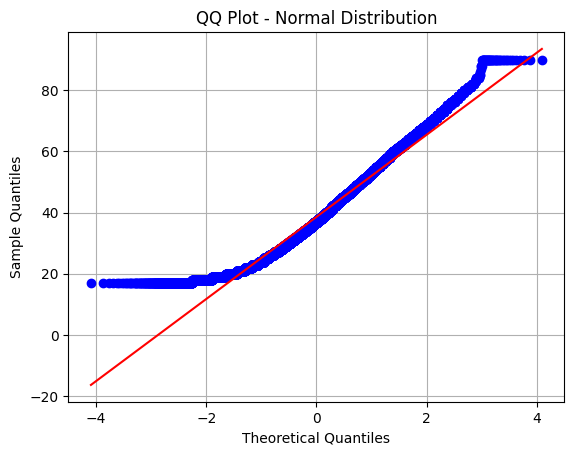

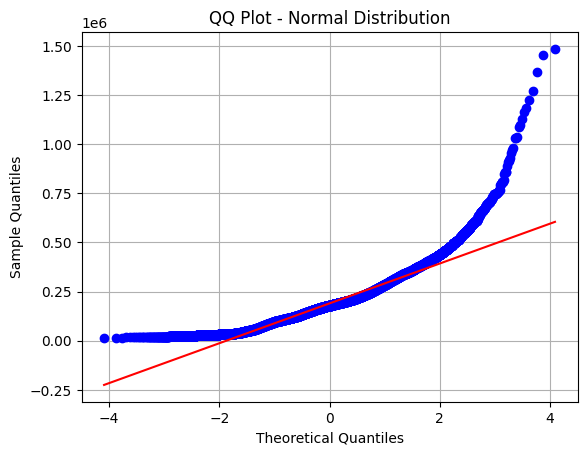

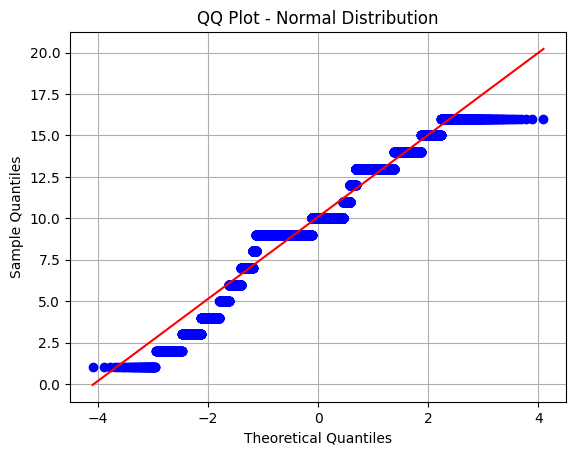

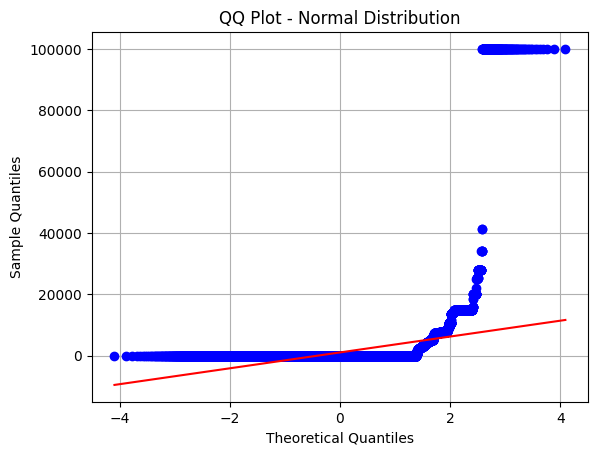

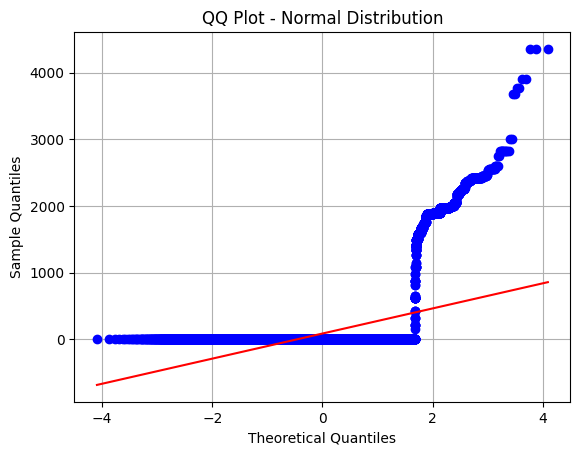

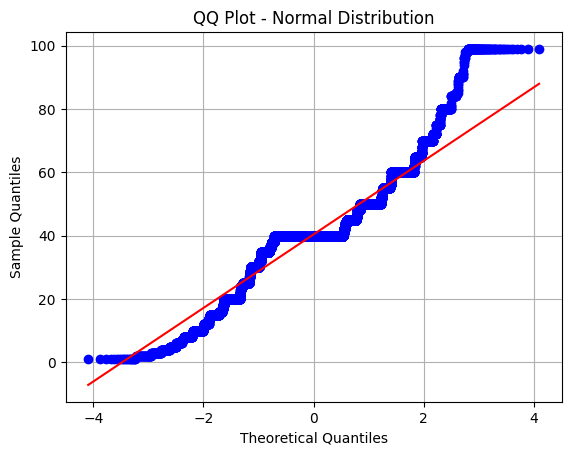

In [ ]:
num_data[num_data==' ?'].isnull().sum() # no question mark is observed or null values
# QQ plot is a graphical tool to compare two probability distributions by plotting their quantiles
# against each other.It's commonly used to assess if two datasets come from populations with a similar distribution. 

for col in num_data.columns:
    stats.probplot(num_data[col],dist='norm',plot=plt)
    plt.title('QQ Plot - Normal Distribution')
    plt.xlabel('Theoretical Quantiles')
    plt.ylabel('Sample Quantiles')
    plt.grid(True)
    plt.show() 
    
    
    # mostly the numeric data closer to  normally distributed

In [14]:
num_data[num_data['age']>78].shape # 143 data points  are above the age 78
num_data[num_data['hours-per-week']>52].shape #3492 likely outliers
num_data[num_data['fnlwgt']>415847].shape #992 
num_data[num_data['hours-per-week']>52].shape 

# necessary apply outlier treatment

for col in num_data.columns:
    fig=px.box(num_data[col])
    fig.show()

fig=px.scatter(data,'country','salary')
fig.show()
fig=px.scatter(data,'workclass','salary')
fig.show()

fig=px.scatter(data,'occupation','salary')
fig.show()

num_data.shape

(32561, 6)

In [ ]:
''' k-nearest neighbors (KNN) imputation or predictive modeling.encode them separately from other categories
Apply target encoding with smoothing techniques to handle potential overfitting and reduce the impact of rare categories.
Smoothing techniques like Laplace smoothing (additive smoothing) or James-Stein estimator
can help mitigate the risk of overfitting by adding a small value to the frequency counts of each category.
one-hot encoding, ordinal encoding, or binary encoding.'''

In [13]:
num_data.describe()
# scale the numeric data 

scale_instance=MinMaxScaler()
scale_pipeline=Pipeline(steps=[('scale_num',scale_instance)])
scaled_fit_model=scale_pipeline.fit(num_data)
#save the pipeline
joblib.dump(scaled_fit_model,'scale_num')

# transform the numeric data 
scaled_data=pd.DataFrame(scaled_fit_model.transform(num_data),columns=num_data.columns)
scaled_data.describe()

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week
count,32561.000000,32561.000000,32561.000000,32561.000000,32561.000000,32561.000000
mean,0.295639,0.120545,0.605379,0.010777,0.020042,0.402423
std,0.186855,0.071685,0.171515,0.073854,0.092507,0.125994
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.150685,0.071679,0.533333,0.000000,0.000000,0.397959
50%,0.273973,0.112788,0.600000,0.000000,0.000000,0.397959
75%,0.424658,0.152651,0.733333,0.000000,0.000000,0.448980
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [14]:
#conat the encoded ands scaled data
a1=pd.concat([scaled_data,enc_data,y],axis=1)
a1

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week,workclass,occupation,country,sex_ Male,...,marital-status_ Married-spouse-absent,marital-status_ Never-married,marital-status_ Separated,marital-status_ Widowed,relationship_ Not-in-family,relationship_ Other-relative,relationship_ Own-child,relationship_ Unmarried,relationship_ Wife,salary
0,0.301370,0.044302,0.800000,0.021740,0.0,0.397959,State-gov,Adm-clerical,United-States,1.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
1,0.452055,0.048238,0.800000,0.000000,0.0,0.122449,Self-emp-not-inc,Exec-managerial,United-States,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.287671,0.138113,0.533333,0.000000,0.0,0.397959,Private,Handlers-cleaners,United-States,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
3,0.493151,0.151068,0.400000,0.000000,0.0,0.397959,Private,Handlers-cleaners,United-States,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,0.150685,0.221488,0.800000,0.000000,0.0,0.397959,Private,Prof-specialty,Cuba,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,0.136986,0.166404,0.733333,0.000000,0.0,0.377551,Private,Tech-support,United-States,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
32557,0.315068,0.096500,0.533333,0.000000,0.0,0.397959,Private,Machine-op-inspct,United-States,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
32558,0.561644,0.094827,0.533333,0.000000,0.0,0.397959,Private,Adm-clerical,United-States,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0
32559,0.068493,0.128499,0.533333,0.000000,0.0,0.193878,Private,Adm-clerical,United-States,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0


In [15]:
# getting the indexes of the '?' rows in the dataset

d_indexes1=a1[a1['workclass']==' ?'].index 

d_indexes2=a1[a1['occupation']==' ?'].index

d_indexes3=a1[a1['country']==' ?'].index


d=d_indexes1.append([d_indexes2,d_indexes3])



#data with '?' variable data  
data_qc=a1.loc[d]
data_qc.drop_duplicates(inplace=True)
data_qc.duplicated().sum()



#without '?" data
data_wc=a1.drop(d)


# target encode the workclass  without question data 
num_data.var()


age               1.860614e+02
fnlwgt            1.114080e+10
education-num     6.618890e+00
capital-gain      5.454254e+07
capital-loss      1.623769e+05
hours-per-week    1.524590e+02
dtype: float64

In [16]:
data_qc.shape #(2398, 27)

f1= a1[(a1['workclass'] == ' ?') & (a1['occupation'] == ' ?') & (a1['country'] == ' ?')] #shape(27 rows× 27 columns)

# the data which will have 3 empty feature values
filtered_data = data_qc[(data_qc['workclass'] == ' ?') & (data_qc['occupation'] == ' ?') & (data_qc['country'] != ' ?')] #shape(1809 rows × 27 columns)
filtered_data


,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week,workclass,occupation,country,sex_ Male,...,marital-status_ Married-spouse-absent,marital-status_ Never-married,marital-status_ Separated,marital-status_ Widowed,relationship_ Not-in-family,relationship_ Other-relative,relationship_ Own-child,relationship_ Unmarried,relationship_ Wife,salary
27,0.506849,0.114048,0.600000,0.000000,0.0,0.602041,?,?,South,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
69,0.109589,0.127950,0.600000,0.000000,0.0,0.397959,?,?,United-States,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0
77,0.684932,0.136153,0.333333,0.000000,0.0,0.010204,?,?,United-States,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
106,0.000000,0.198712,0.333333,0.340953,0.0,0.316327,?,?,United-States,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0
128,0.246575,0.079475,0.533333,0.000000,0.0,0.397959,?,?,United-States,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32530,0.246575,0.209043,0.800000,0.000000,0.0,0.551020,?,?,United-States,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1
32531,0.178082,0.014619,0.800000,0.000000,0.0,1.000000,?,?,United-States,0.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
32539,0.739726,0.186826,1.000000,0.000000,0.0,0.091837,?,?,United-States,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
32541,0.328767,0.129404,0.533333,0.000000,0.0,0.316327,?,?,United-States,0.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0


In [21]:
#chisquared test -- to check the association between categorical features.if p<0.05 it indicates the features are associated
#tetrachoric correlation-- for binary categorical variables 
#polychoric corr--for ordinal categorical variables
#
contingency_table=pd.crosstab(a1['occupation'],a1['workclass'])

chi2,p,dof,expected=chi2_contingency(contingency_table)
print("chi_squared statistic,pvalue",chi2,p)


#as pvalue=0 , it suggests strong evidence against the null hypothesis of independence 


contingency_table=pd.crosstab(a1['occupation'],a1['country'])

chi2,p,dof,expected=chi2_contingency(contingency_table)
print("chi_squared statistic,pvalue",chi2,p)

contingency_table=pd.crosstab(a1['country'],a1['workclass'])

chi2,p,dof,expected=chi2_contingency(contingency_table)
print("chi_squared statistic,pvalue",chi2,p)

# thus implies country,occupation,workclass have a strong association with one other 



chi_squared statistic,pvalue 41676.64797359809 0.0
chi_squared statistic,pvalue 2437.2965238719535 3.056006193732551e-227
chi_squared statistic,pvalue 546.6416205335809 3.6510642780637936e-13


In [18]:
px.histogram(a1['country']).show()
#implementation of dt
a3=data_wc[['workclass','occupation','country']]
a2=data_wc.drop(a3,axis=1)
a2

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week,sex_ Male,race_ Asian-Pac-Islander,race_ Black,race_ Other,...,marital-status_ Married-spouse-absent,marital-status_ Never-married,marital-status_ Separated,marital-status_ Widowed,relationship_ Not-in-family,relationship_ Other-relative,relationship_ Own-child,relationship_ Unmarried,relationship_ Wife,salary
0,0.301370,0.044302,0.800000,0.021740,0.0,0.397959,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
1,0.452055,0.048238,0.800000,0.000000,0.0,0.122449,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,0.287671,0.138113,0.533333,0.000000,0.0,0.397959,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0
3,0.493151,0.151068,0.400000,0.000000,0.0,0.397959,1.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,0.150685,0.221488,0.800000,0.000000,0.0,0.397959,0.0,0.0,1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,0.136986,0.166404,0.733333,0.000000,0.0,0.377551,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0
32557,0.315068,0.096500,0.533333,0.000000,0.0,0.397959,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1
32558,0.561644,0.094827,0.533333,0.000000,0.0,0.397959,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0
32559,0.068493,0.128499,0.533333,0.000000,0.0,0.193878,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0


In [22]:
# Split dataset
X_train, X_test, y_train, y_test = train_test_split(a2, a3['workclass'], test_size=0.2,random_state=42,stratify=a3['workclass'])
instance1=LogisticRegression(penalty='elasticnet',random_state=42,solver='saga',l1_ratio=0.65)

pre_model=instance1.fit(X_train, y_train)
prediction=pre_model.predict(X_test)

prediction

accuracy_score(y_test,prediction) 

 
report=classification_report(y_test,prediction)
#print("Classification Report:")
print(report)
instance1.get_params


                   precision    recall  f1-score   support

      Federal-gov       0.00      0.00      0.00       188
        Local-gov       1.00      0.00      0.00       413
          Private       0.74      1.00      0.85      4458
     Self-emp-inc       0.45      0.02      0.04       215
 Self-emp-not-inc       0.30      0.01      0.01       500
        State-gov       0.00      0.00      0.00       256
      Without-pay       0.00      0.00      0.00         3

         accuracy                           0.74      6033
        macro avg       0.36      0.15      0.13      6033
     weighted avg       0.66      0.74      0.63      6033



c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



<bound method BaseEstimator.get_params of LogisticRegression(l1_ratio=0.65, penalty='elasticnet', random_state=42,
                   solver='saga')>

In [38]:
# Split dataset
X_train, X_test, y_train, y_test = train_test_split(a2, a3['workclass'], test_size=0.2,random_state=42,stratify=a3['workclass'])

param_dist={'penalty':['l1','l2','elasticnet'],
            'solver':['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
             'max_iter':[50,100,250,500,1000,1500],
             'C':uniform(0.1,100)
            }

#n_iter--it determines how many different combinations of hyperparameters will be tried.
#max_iter in param_dist represents the maximum number of iterations taken for the solvers to converge.
instance_opt=RandomizedSearchCV(LogisticRegression(n_jobs=-1),param_distributions=param_dist,n_iter=20,cv=5,random_state=42)

#fit the model with randomization
instance_opt.fit(X_train,y_train)
print("best_parameters found :",instance_opt.best_params_)
print("best_scores found :",instance_opt.best_score_)



# Evaluate the model on the test set
print("Test set score with best parameters: ",instance_opt.score(X_test, y_test))


c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_sag.py:350: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

c:\Users\Tippu\AppData\Local\Progra

best_parameters found : {'C': 60.85448519014384, 'max_iter': 1000, 'penalty': 'l1', 'solver': 'liblinear'}
best_scores found : 0.7401467182296242
Test set score with best parameters:  0.7316426321896238


In [23]:
# Split dataset
X_train, X_test, y_train, y_test = train_test_split(a2, a3['workclass'], test_size=0.2,random_state=42,stratify=a3['workclass'])
instance1=LogisticRegression(C= 60.85448519014384, max_iter= 1000, penalty= 'l1', solver= 'liblinear',n_jobs=-1)

pre_model=instance1.fit(X_train, y_train)
prediction=pre_model.predict(X_test)

prediction

accuracy_score(y_test,prediction) 

 
report=classification_report(y_test,prediction)
#print("Classification Report:")
print(report)


c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\linear_model\_logistic.py:1216: UserWarning:

'n_jobs' > 1 does not have any effect when 'solver' is set to 'liblinear'. Got 'n_jobs' = 12.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples

                   precision    recall  f1-score   support

      Federal-gov       0.00      0.00      0.00       188
        Local-gov       1.00      0.00      0.00       413
          Private       0.74      1.00      0.85      4458
     Self-emp-inc       0.43      0.01      0.03       215
 Self-emp-not-inc       0.27      0.01      0.01       500
        State-gov       0.00      0.00      0.00       256
      Without-pay       0.00      0.00      0.00         3

         accuracy                           0.74      6033
        macro avg       0.35      0.15      0.13      6033
     weighted avg       0.65      0.74      0.63      6033



In [24]:

# Split dataset
X_train, X_test, y_train, y_test = train_test_split(a2, a3['workclass'], test_size=0.2,random_state=42,stratify=a3['workclass'])

instance1=DecisionTreeClassifier(criterion='log_loss',splitter='best',random_state=42)

pre_model=instance1.fit(X_train, y_train)
prediction=pre_model.predict(X_test)

prediction
accuracy_score(y_test,prediction) #58.58%
report=classification_report(y_test,prediction)
print("Classification Report:")
print(report)

Classification Report:
                   precision    recall  f1-score   support

      Federal-gov       0.07      0.09      0.08       188
        Local-gov       0.10      0.10      0.10       413
          Private       0.77      0.74      0.75      4458
     Self-emp-inc       0.06      0.07      0.06       215
 Self-emp-not-inc       0.17      0.18      0.18       500
        State-gov       0.08      0.09      0.09       256
      Without-pay       0.00      0.00      0.00         3

         accuracy                           0.58      6033
        macro avg       0.18      0.18      0.18      6033
     weighted avg       0.59      0.58      0.59      6033



c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [25]:

# applying knn algorithm 
# Split dataset
X_train1, X_test1, y_train1, y_test1 = train_test_split(a2, a3['workclass'], test_size=0.2,random_state=42,stratify=a3['occupation'])

# Create KNN classifier
k = 5  # Number of neighbors
knn_classifier = KNeighborsClassifier(n_neighbors=k)

# Train the classifier
knn_classifier.fit(X_train1, y_train1)

# Make predictions on the test set
prediction1 = knn_classifier.predict(X_test1)

# Evaluate accuracy
accuracy = accuracy_score(y_test1, prediction1)
print("Accuracy:", accuracy) #71%


report1=classification_report(y_test1,prediction1)
print(report1) #70.41%

Accuracy: 0.7037957898226421
                   precision    recall  f1-score   support

      Federal-gov       0.05      0.02      0.03       202
        Local-gov       0.15      0.07      0.09       386
          Private       0.75      0.94      0.83      4416
     Self-emp-inc       0.13      0.03      0.05       214
 Self-emp-not-inc       0.31      0.08      0.13       536
        State-gov       0.12      0.01      0.02       278
      Without-pay       0.00      0.00      0.00         1

         accuracy                           0.70      6033
        macro avg       0.22      0.16      0.16      6033
     weighted avg       0.60      0.70      0.63      6033



c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



##country missing values handling

In [26]:
# applying knn algorithm 

# Split dataset
X_train2, X_test2, y_train2, y_test2 = train_test_split(a2, a3['country'], test_size=0.2,random_state=42,stratify=a3['occupation'])



# Create KNN classifier
k =5 # Number of neighbors
knn_classifier_final = KNeighborsClassifier(weights='distance',n_neighbors=k,n_jobs=-1,p=2)

# Train the classifier
knn_classifier_final.fit(X_train2, y_train2)

# Make predictions on the test set
prediction2 = knn_classifier_final.predict(X_test2)

# Evaluate accuracy
accuracy = accuracy_score(y_test2, prediction2)
print("Accuracy:", accuracy) #91.32%


report1=classification_report(y_test2,prediction2)
print(report1) 

Accuracy: 0.9129786176031826
                             precision    recall  f1-score   support

                   Cambodia       0.00      0.00      0.00         2
                     Canada       0.00      0.00      0.00        25
                      China       0.20      0.06      0.09        18
                   Columbia       0.00      0.00      0.00        15
                       Cuba       0.00      0.00      0.00        14
         Dominican-Republic       0.00      0.00      0.00        16
                    Ecuador       0.25      0.20      0.22         5
                El-Salvador       0.50      0.08      0.13        13
                    England       0.00      0.00      0.00        14
                     France       0.00      0.00      0.00         6
                    Germany       0.00      0.00      0.00        24
                     Greece       0.00      0.00      0.00         3
                  Guatemala       0.20      0.07      0.11        14
    

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [27]:
d_qc=data_qc.drop(['occupation','workclass','country'],axis=1)
d_qc['predicted_country']=knn_classifier_final.predict(d_qc)
px.histogram(d_qc['predicted_country']).show()
px.histogram(data['country']).show()

In [29]:
#approach 1
#rscv--best_parameters found : {'weights': 'uniform', 'p': 1, 'n_neighbors': 25}, best_scores found : 0.9149570998198445

# Split dataset
X_train2, X_test2, y_train2, y_test2 = train_test_split(a2, a3['country'], test_size=0.2,random_state=42,stratify=a3['occupation'])


param_dist={'weights':['distance','uniform'],
            'n_neighbors':[5,10,15,25],
            'p':[1,2]
            }

#n_iter--it determines how many different combinations of hyperparameters will be tried.
#max_iter in param_dist represents the maximum number of iterations taken for the solvers to converge.
instance_opt1=GridSearchCV(KNeighborsClassifier(n_jobs=-1),param_dist,cv=5)

#fit the model with randomization
instance_opt1.fit(X_train2,y_train2)
print("best_parameters found :",instance_opt1.best_params_)
print("best_scores found :",instance_opt1.best_score_)



# Evaluate the model on the test set
print("Test set score with best parameters: ",instance_opt1.score(X_test2, y_test2))

k =25 # Number of neighbors
knn_classifier = KNeighborsClassifier(weights='distance',n_neighbors=k,n_jobs=-1)

# Train the classifier
knn_classifier.fit(X_train2, y_train2)

# Make predictions on the test set
prediction2 = knn_classifier.predict(X_test2)

# Evaluate accuracy
accuracy = accuracy_score(y_test2, prediction2)
print("Accuracy:", accuracy) #92% 


report1=classification_report(y_test2,prediction2)
print(report1) # micr avg results are not good as baseline result and also  all the variables dont have good f1score 


c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_split.py:737: UserWarning:

The least populated class in y has only 1 members, which is less than n_splits=5.



KeyboardInterrupt: 

In [98]:
#approach 2
# Split dataset
X_train4, X_test4, y_train4, y_test4 = train_test_split(a2, a3['country'], test_size=0.2,random_state=42,stratify=a3['occupation'])
instance4=DecisionTreeClassifier()
#criterion='gini',splitter='best',random_state=42
pre_model4=instance4.fit(X_train4, y_train4)
prediction4=pre_model4.predict(X_test4)

prediction4
accuracy_score(y_test4,prediction4) #86%
 
report4=classification_report(y_test4,prediction4)
#print("Classification Report:")
print(report4)

X_train4, X_test4, y_train4, y_test4 = train_test_split(a2, a3['country'], test_size=0.2,random_state=42,stratify=a3['occupation'])

param_dist={'criterion':['gini', 'entropy', 'log_loss'],
            'splitter':['best', 'random'],
            'min_samples_split':[2,5,7,11,15,25,50],
            'min_samples_leaf':[1,3,5,7,10,15],
            'max_features':['int', 'float', 'sqrt', 'log2'],
            'random_state':[0,21,42,61,100,250]
            }

instance_opt4=GridSearchCV(DecisionTreeClassifier(),param_dist,cv=5)

#fit the model with randomization
instance_opt4.fit(X_train4,y_train4)


print("best_scores found :",instance_opt4.best_score_)
print("best_parameters found :",instance_opt4.best_params_)
#eatures': 'sqrt', 'min_samples_leaf': 15, 'min_samples_split': 2, 'random_state': 61, 'splitter': 'best'

instance5=DecisionTreeClassifier(criterion= 'gini', max_features= 'sqrt', min_samples_leaf= 15, min_samples_split= 2,random_state=61,splitter= 'best')
#criterion='gini',splitter='best',random_state=42
pre_model5=instance5.fit(X_train4, y_train4)
prediction5=pre_model4.predict(X_test4)

prediction5
accuracy_score(y_test4,prediction5) #86%
 
report5=classification_report(y_test4,prediction5)
#print("Classification Report:")
print(report5)


print("best_parameters found :",instance_opt4.best_params_)


instance4=DecisionTreeClassifier(criterion= 'gini', max_features= 'log2', min_samples_leaf= 10, min_samples_split= 5, splitter= 'best',random_state=0)
#criterion='gini',splitter='best',random_state=42
pre_model4=instance4.fit(X_train4, y_train4)
prediction4=pre_model4.predict(X_test4)

prediction4
accuracy_score(y_test4,prediction4) #86%
 
report4=classification_report(y_test4,prediction4)
#print("Classification Report:")
print(report4)

# both give similar results though very much lack in macro avg scores  with 92% accuracy


best_parameters found : {'criterion': 'gini', 'max_features': 'sqrt', 'min_samples_leaf': 15, 'min_samples_split': 2, 'random_state': 61, 'splitter': 'best'}
                             precision    recall  f1-score   support

                   Cambodia       0.00      0.00      0.00         2
                     Canada       0.00      0.00      0.00        25
                      China       0.00      0.00      0.00        18
                   Columbia       0.00      0.00      0.00        15
                       Cuba       0.00      0.00      0.00        14
         Dominican-Republic       0.33      0.06      0.11        16
                    Ecuador       0.00      0.00      0.00         5
                El-Salvador       0.00      0.00      0.00        13
                    England       0.00      0.00      0.00        14
                     France       0.00      0.00      0.00         6
                    Germany       0.00      0.00      0.00        24
             

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [70]:
# Split dataset
X_train3, X_test3, y_train3, y_test3 = train_test_split(a2, a3['country'], test_size=0.2,random_state=42,stratify=a3['occupation'])
instance3=LogisticRegression()

pre_model3=instance3.fit(X_train3, y_train3)
prediction3=pre_model3.predict(X_test3)

prediction3

accuracy_score(y_test3,prediction3) #92%

 
report3=classification_report(y_test3,prediction3)
#print("Classification Report:")
print(report3)


X_train3, X_test3, y_train3, y_test3 = train_test_split(a2, a3['country'], test_size=0.2,random_state=42,stratify=a3['occupation'])

param_dist={'penalty':['l1','l2','elasticnet'],
            'solver':['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
             'max_iter':[50,100,250,500,1000],
            }

#n_iter--it determines how many different combinations of hyperparameters will be tried.
#max_iter in param_dist represents the maximum number of iterations taken for the solvers to converge.
instance_opt3=GridSearchCV(LogisticRegression(n_jobs=-1),param_dist,cv=5)

#fit the model with randomization
instance_opt3.fit(X_train3,y_train3)
  #91.45%

print("best_parameters found :",instance_opt3.best_params_)
print("best_scores found :",instance_opt3.best_score_)
#best_parameters found : {'C': 0.8751328233611145, 'max_iter': 100, 'penalty': 'l2', 'solver': 'saga'

## Evaluate the model on the test set
print("Test set score with best parameters: ",instance_opt3.score(X_test3, y_test3))

instance3=LogisticRegression( max_iter= 50, penalty= 'l1', solver= 'saga',n_jobs=-1)
#C= 0.8751328233611145, max_iter= 100, penalty= 'l2', solver= 'saga',n_jobs=-1
#'max_iter': 50, 'penalty': 'l1', 'solver': 'saga'
pre_model3=instance3.fit(X_train3, y_train3)
prediction3=pre_model3.predict(X_test3)

prediction3

accuracy_score(y_test3,prediction3) #92%

 
report3=classification_report(y_test3,prediction3)
#print("Classification Report:")
print(report3)


                             precision    recall  f1-score   support

                   Cambodia       0.00      0.00      0.00         2
                     Canada       0.00      0.00      0.00        25
                      China       0.00      0.00      0.00        18
                   Columbia       0.00      0.00      0.00        15
                       Cuba       0.00      0.00      0.00        14
         Dominican-Republic       1.00      0.06      0.12        16
                    Ecuador       0.00      0.00      0.00         5
                El-Salvador       0.00      0.00      0.00        13
                    England       0.00      0.00      0.00        14
                     France       0.00      0.00      0.00         6
                    Germany       0.00      0.00      0.00        24
                     Greece       0.00      0.00      0.00         3
                  Guatemala       0.00      0.00      0.00        14
                      Haiti      

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\Tippu\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [32]:
# Initialize KFold cross-validation with 5 folds
kf=KFold(n_splits=5,shuffle=True,random_state=42)
kf.split(data_wc)

col=['occupation','country']
# initialize the target encoderr
enocder_te=TargetEncoder(cols=col)

#initialse empty list to store results
encoded_values=[]

#perform kfold target encoding

for train_index,val_index in kf.split(data_wc):
    #split the data into training and validation sets
    x_train,x_val=data_wc.iloc[train_index],data_wc.iloc[val_index]
    
    #fit the target encoder on training_data
    enocder_te.fit(x_train[col],x_train['salary'])
    
    #apply encoding to validation data 
    x_val_encoded=enocder_te.transform(x_val[col])
    
    #append encoding resullts to the list 
    encoded_values.append(x_val_encoded)
    
    #avg encoding results across all folds
    final_encoded_values=sum(encoded_values)/len(encoded_values)
    
    print(final_encoded_values)


       occupation   country
6        0.043787  0.100796
7        0.480038  0.253185
18       0.270121  0.253185
31       0.270121  0.253185
35       0.120075  0.101271
...           ...       ...
32515    0.228103  0.253185
32538    0.446605  0.253185
32549    0.133829  0.253185
32555    0.324952  0.253185
32560    0.480038  0.253185

[6033 rows x 2 columns]
       occupation  country
3             NaN      NaN
6             NaN      NaN
7             NaN      NaN
18            NaN      NaN
20            NaN      NaN
...           ...      ...
32549         NaN      NaN
32550         NaN      NaN
32555         NaN      NaN
32558         NaN      NaN
32560         NaN      NaN

[12066 rows x 2 columns]
       occupation  country
0             NaN      NaN
3             NaN      NaN
4             NaN      NaN
5             NaN      NaN
6             NaN      NaN
...           ...      ...
32552         NaN      NaN
32554         NaN      NaN
32555         NaN      NaN
32558         NaN  

from difflib import SequenceMatcher
import pandas as pd
import numpy as np


# Function to compute distance between two rows, handling null or unknown characters
def row_distance(row1, row2):
    distance = 0
    for val1, val2 in zip(row1, row2):
        if pd.isnull(val1) or val1 == ' ?' or pd.isnull(val2) or val2 == ' ?':
            continue  # Skip null or unknown values
        distance += (val1 - val2) ** 2  # Euclidean distance
    return np.sqrt(distance)

# Function to find closely similar rows between two dataframes
def find_similar_rows(df1, df2, threshold=0.9):
    similar_rows = []
    for index1, row1 in df1.iterrows():
        for index2, row2 in df2.iterrows():
            distance = row_distance(row1, row2)
            if distance <= threshold:
                similar_rows.append((index1, index2, distance))
    return similar_rows

# Call the function to find closely similar rows
similar_rows = find_similar_rows(data_w,data_q)

# Print the closely similar rows
if similar_rows:
    print("Closely similar rows found:")
    for index1, index2, distance in similar_rows:
        print(f"Row {index1} in df1 is similar to Row {index2} in df2 with a distance of {distance}")
else:
    print("No closely similar rows found.")
